## Zulfidin (Bobojon) Khodzhaev 

#### Different MLP configurations on the California Housing and the Diabetes datasets.

In [1]:
%matplotlib inline

In [2]:
import numpy as np
from copy import deepcopy
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import LinearRegression
from sklearn.datasets import fetch_california_housing, load_diabetes

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [3]:
seed = 42

In [4]:
# Load the Calinifornia Housing dataset and do train/val/test split
california_housing = fetch_california_housing()
housing_X, housing_y = california_housing['data'], california_housing['target']
housing_X_train, housing_X_tmp, housing_y_train, housing_y_tmp = train_test_split(housing_X, housing_y, test_size=0.4, random_state=seed)
housing_X_val, housing_X_test, housing_y_val, housing_y_test = train_test_split(housing_X_tmp, housing_y_tmp, test_size=0.5, random_state=seed)

housing_scaler = StandardScaler()
housing_X_train = housing_scaler.fit_transform(housing_X_train)
housing_X_val = housing_scaler.transform(housing_X_val)
housing_X_test = housing_scaler.transform(housing_X_test)
print(california_housing['DESCR'])

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived

In [5]:
# Load the Diabetes dataset and do train/val/test split
diabetes = load_diabetes()
diabetes_X, diabetes_y = diabetes['data'], diabetes['target']

diabetes_X_train, diabetes_X_tmp, diabetes_y_train, diabetes_y_tmp = train_test_split(diabetes_X, diabetes_y, test_size=0.4, random_state=seed)
diabetes_X_val, diabetes_X_test, diabetes_y_val, diabetes_y_test = train_test_split(diabetes_X_tmp, diabetes_y_tmp, test_size=0.5, random_state=seed)

diabetes_scaler = StandardScaler()
diabetes_X_train = diabetes_scaler.fit_transform(diabetes_X_train)
diabetes_X_val = diabetes_scaler.transform(diabetes_X_val)
diabetes_X_test = diabetes_scaler.transform(diabetes_X_test)
print(diabetes['DESCR'])

.. _diabetes_dataset:

Diabetes dataset
----------------

Ten baseline variables, age, sex, body mass index, average blood
pressure, and six blood serum measurements were obtained for each of n =
442 diabetes patients, as well as the response of interest, a
quantitative measure of disease progression one year after baseline.

**Data Set Characteristics:**

  :Number of Instances: 442

  :Number of Attributes: First 10 columns are numeric predictive values

  :Target: Column 11 is a quantitative measure of disease progression one year after baseline

  :Attribute Information:
      - age     age in years
      - sex
      - bmi     body mass index
      - bp      average blood pressure
      - s1      tc, total serum cholesterol
      - s2      ldl, low-density lipoproteins
      - s3      hdl, high-density lipoproteins
      - s4      tch, total cholesterol / HDL
      - s5      ltg, possibly log of serum triglycerides level
      - s6      glu, blood sugar level

Note: Each of these 1

Training and evaluation functions of the MLP. Using:

*   **hidden_layer_size**: given by train_mlp parameter
*   **learning_rate_init**: given by a list of search space
*   **random_state**: given by train_mlp parameter
*   **max_iter**: fix at 300



In [6]:
def train_mlp(hidden_layer_size, X_train, y_train, X_val, y_val, seed):
    learning_rate_list = [1e-1, 1e-2, 1e-3, 1e-4]
    best_r2 = -np.inf # Determine the best model based on the R2 score on validation set # TO HIDE
    for lr in learning_rate_list:
        
        # Initialize MLPRegressor
        mlp_regressor = MLPRegressor(hidden_layer_sizes=hidden_layer_size,
                           learning_rate_init=lr,
                           random_state=seed,
                           max_iter=300)

        # Fit the MLPRegressor to training data
        mlp_regressor.fit(X_train, y_train)

        # Predict and evaluate on train and validation data
        mse_train, r2_train = eval_model(mlp_regressor, X_train, y_train)
        mse_val, r2_val = eval_model(mlp_regressor, X_val, y_val)
        print(f"Learning rate: {lr} MSE train: {mse_train} R2 train: {r2_train} MSE val: {mse_val} R2 val: {r2_val}")

        # Record the best model according to R2 score on validation set
        if r2_val > best_r2:
            ### START CODE ###
            best_r2 = r2_val
            best_model = mlp_regressor
            best_lr = lr
            ### END CODE ###

    return best_model, best_lr, best_r2

def eval_model(model, X, y):
    # Predict and evaluate
    y_pred = model.predict(X)
    mse = mean_squared_error(y, y_pred)
    r2 = r2_score(y, y_pred)
    return mse, r2

Two MLPs on the **housing dataset** with the following two different hidden layer size configurations and show their **MSE** and **R2 score** on the **test set**.
*   (8)
*   (64, 64)

In [7]:
best_model_8, best_lr_8, best_r2_8 = train_mlp((8,), housing_X_train, housing_y_train, housing_X_val, housing_y_val, seed)
mse_test_8, r2_test_8 = eval_model(best_model_8, housing_X_test, housing_y_test)
print(f"Best model with 8 hidden units - Test MSE: {mse_test_8}, Test R2: {r2_test_8}")

Learning rate: 0.1 MSE train: 0.3502752532998555 R2 train: 0.735982815076111 MSE val: 0.37267740826682394 R2 val: 0.714497094986974
Learning rate: 0.01 MSE train: 0.334521824008715 R2 train: 0.7478568370492932 MSE val: 0.35351651284456515 R2 val: 0.7291759866620738
Learning rate: 0.001 MSE train: 0.3343894234574139 R2 train: 0.7479566329112834 MSE val: 0.3549904264505432 R2 val: 0.7280468422414288
Learning rate: 0.0001 MSE train: 0.4331418308870668 R2 train: 0.673522791615294 MSE val: 0.4592155463352194 R2 val: 0.6482014482295081
Best model with 8 hidden units - Test MSE: 0.35000842201340565, Test R2: 0.7447291587040576


/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


In [8]:
best_model_64_64, best_lr_64_64, best_r2_64_64 = train_mlp((64, 64), housing_X_train, housing_y_train, housing_X_val, housing_y_val, seed)
mse_test_64_64, r2_test_64_64 = eval_model(best_model_64_64, housing_X_test, housing_y_test)
print(f"Best model with 64, 64 hidden units - Test MSE: {mse_test_64_64}, Test R2: {r2_test_64_64}")

Learning rate: 0.1 MSE train: 0.30357030905774246 R2 train: 0.7711862951526036 MSE val: 0.33161196328557385 R2 val: 0.7459567530658595
Learning rate: 0.01 MSE train: 0.1685481339949054 R2 train: 0.8729581851921032 MSE val: 0.3097709668007966 R2 val: 0.7626888323560499
Learning rate: 0.001 MSE train: 0.2058412426173804 R2 train: 0.8448488013209626 MSE val: 0.28680314360190856 R2 val: 0.780284157695474
Learning rate: 0.0001 MSE train: 0.26741512902207076 R2 train: 0.7984379744062986 MSE val: 0.31262030057434054 R2 val: 0.760505997948454
Best model with 64, 64 hidden units - Test MSE: 0.2714596719780809, Test R2: 0.8020169387778012


/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


A **linear regression model** on the **housing dataset** and show their MSE and R2 scores on the test set.

In [9]:
# Initialize 
linear_model = LinearRegression()
linear_model.fit(housing_X_train, housing_y_train)

# Evaluate
linear_mse = mean_squared_error(housing_y_test, linear_model.predict(housing_X_test))
linear_r2 = r2_score(housing_y_test, linear_model.predict(housing_X_test))

print(f"Linear Regression Model - MSE: {linear_mse}, R2 Score: {linear_r2}")


Linear Regression Model - MSE: 0.5546246533101034, R2 Score: 0.5954968710766684


It achieved the following performance on the test set:

MSE: 0.55
R2 Score: 0.59

Comparing this to the MLP models:

The MLP with 64,64 hidden units had test MSE of 0.027 and R2 of 0.802.
The MLP with 8 hidden units had test MSE of 0.035 and R2 of 0.74.
The linear regression model performed worse than both MLP models on the housing dataset. This is likely because the housing dataset has complex non-linear relationships between the features and target that cannot be captured effectively by a linear model. The MLP with its hidden layers is able to model these non-linearities better and achieve lower error and higher R2 score. The increased complexity of the MLP allows it to fit the intricacies of the housing dataset better.

Two MLPs on the **diabetes dataset** with the following two different hidden layer size configurations and show their **MSE** and **R2 score** on the **test set**.
*   (8)
*   (64, 64)

In [10]:
best_model_8, best_lr_8, best_r2_8 = train_mlp((8,), diabetes_X_train, diabetes_y_train, diabetes_X_val, diabetes_y_val, seed)
mse_test_8, r2_test_8 = eval_model(best_model_8, diabetes_X_test, diabetes_y_test)
print(f"Best model with 8 hidden units - Test MSE: {mse_test_8}, Test R2: {r2_test_8}")

Learning rate: 0.1 MSE train: 2476.3467595024326 R2 train: 0.585898539459291 MSE val: 2517.632414913162 R2 val: 0.5632838571464869
Learning rate: 0.01 MSE train: 2923.510957077445 R2 train: 0.5111225224872039 MSE val: 2897.769455293564 R2 val: 0.4973441349506217


/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(
/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


Learning rate: 0.001 MSE train: 23187.857938274905 R2 train: -2.8775368603787332 MSE val: 21269.44841782192 R2 val: -2.689462932964871
Learning rate: 0.0001 MSE train: 28400.91006149956 R2 train: -3.7492776575100377 MSE val: 26368.757515117697 R2 val: -3.5740045312528217
Best model with 8 hidden units - Test MSE: 3031.3140854025273, Test R2: 0.4759604846674894


/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


In [11]:
best_model_64_64, best_lr_64_64, best_r2_64_64 = train_mlp((64, 64), diabetes_X_train, diabetes_y_train, diabetes_X_val, diabetes_y_val, seed)
mse_test_64_64, r2_test_64_64 = eval_model(best_model_64_64, diabetes_X_test, diabetes_y_test)
print(f"Best model with 64, 64 hidden units - Test MSE: {mse_test_64_64}, Test R2: {r2_test_64_64}")

Learning rate: 0.1 MSE train: 1206.4253098148079 R2 train: 0.7982582685924126 MSE val: 3723.5437400131705 R2 val: 0.354102826825502
Learning rate: 0.01 MSE train: 2243.706391797441 R2 train: 0.6248012963844647 MSE val: 2647.383790966997 R2 val: 0.5407767905292495


/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


Learning rate: 0.001 MSE train: 2708.36400051836 R2 train: 0.5470999834789378 MSE val: 2934.4456382474004 R2 val: 0.49098217318872495
Learning rate: 0.0001 MSE train: 25172.631134438427 R2 train: -3.2094360486565927 MSE val: 23365.034950969686 R2 val: -3.05296971908306
Best model with 64, 64 hidden units - Test MSE: 3048.801456733654, Test R2: 0.47293734904425155


/Users/zulfidinkhodzhaev/opt/anaconda3/envs/skyrmion/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (300) reached and the optimization hasn't converged yet.
  warnings.warn(


Linear regression model on the **diabetes dataset** and show its **MSE** and **R2 score** on the **test set**.

In [12]:
# Initialize
linear_model_diabetes = LinearRegression()
linear_model_diabetes.fit(diabetes_X_train, diabetes_y_train)

# Evaluate
linear_mse_diabetes = mean_squared_error(diabetes_y_test, linear_model_diabetes.predict(diabetes_X_test))
linear_r2_diabetes = r2_score(diabetes_y_test, linear_model_diabetes.predict(diabetes_X_test))

print(f"Linear Regression Model on diabetes dataset - MSE: {linear_mse_diabetes}, R2 Score: {linear_r2_diabetes}")

Linear Regression Model on diabetes dataset - MSE: 3245.611400975238, R2 Score: 0.4389137589815666


On the housing dataset:

Linear: MSE: 0.55, R2 Score: 0.59
The MLP with 64,64 hidden units had test MSE of 0.027 and R2 of 0.802.
The MLP with 8 hidden units had test MSE of 0.035 and R2 of 0.74.

On the diabetes dataset:

The linear regression model performed the best with test MSE of 3245 and R2 of 0.43.
The MLP with 64,64 hidden units had performance with test MSE of 3048 and R2 of 0.470.
The MLP with 8 hidden units had the performance with test MSE of 3031.3 and R2 of 0.47.

So the performance order is different between the two datasets. On the housing dataset, the MLP models outperformed linear regression, while on the diabetes dataset linear regression was better than the MLPs.

This is likely because: The housing dataset has more complex non-linear relationships that the MLP can capture better than linear regression. The diabetes dataset may have more linear relationships that the linear model is better at capturing than the more flexible MLP.

[Tensorflow Playground](https://playground.tensorflow.org).


 DEFAULT settings:


*   Learning rate = 0.03
*   Activation = Tanh
*   Regularization = None
*   Ratio of training to test data = 50%
*   Noise = 0
*   Batch Size = 30
*   input as  𝑋1  with  𝑋2
*   One hidden layer with 4 neurons

Running two experiments -

1.   Using Tanh as the activation function
2.   Using the Linear activation function.


Effect of number of hidden unit. 

Effect of Learning rate and number of epochs. 

Effect of the number of layers. 

After 1,000 epochs, the model using the Tanh activation had training and test losses of 0.012 and 0.014. The model with the Linear activation had higher losses: 0.495 for training and 0.514 for testing. Looking at the decision boundaries, the Tanh model made a clear, curved line that separated the data well. The Linear model's line was less clear and didn't separate the data as effectively. This difference is because Tanh can handle complex data patterns better than Linear, especially when the data isn't in a straight line.

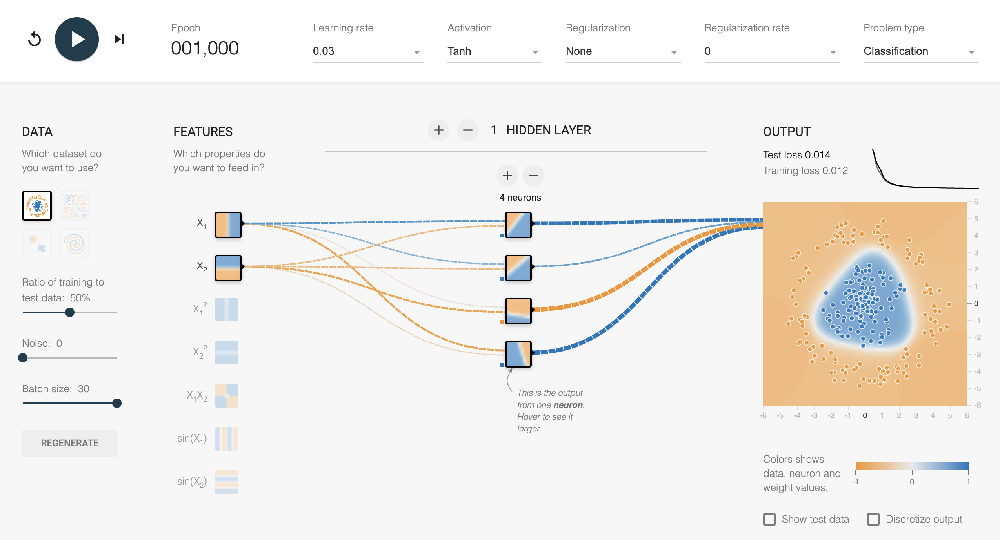
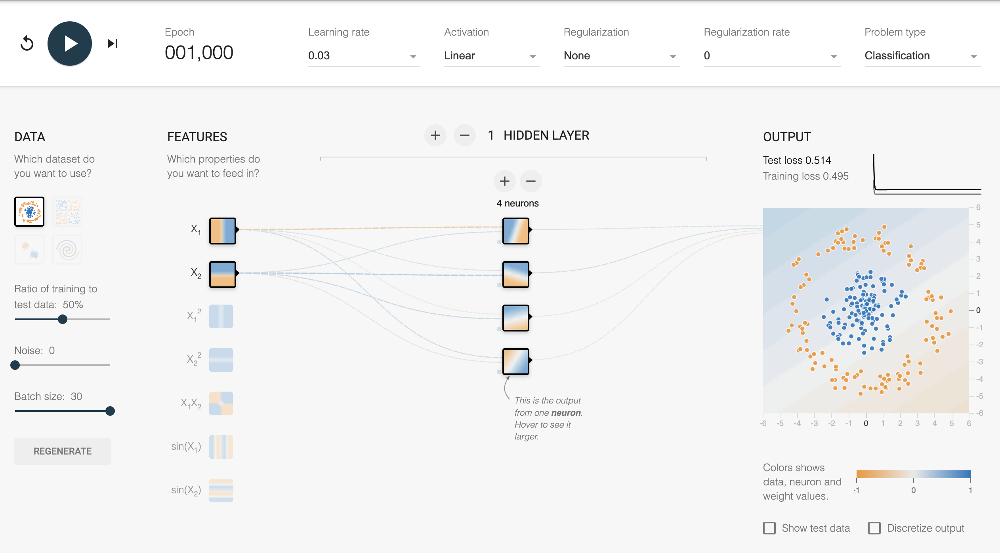





After 1,000 epochs with 2 neurons and Tanh activation, the training and test losses were 0.205 and 0.298 respectively. With 8 neurons, the losses improved significantly to 0.007 for training and 0.017 for testing. The decision boundary became much more refined with 8 neurons, wrapping around the data clusters accurately. This shows that increasing the neurons allows the network to better capture complex patterns in the data, especially when combined with a non-linear activation like Tanh. This is because more neurons provide greater flexibility to the model, enabling it to fit the data more precisely.

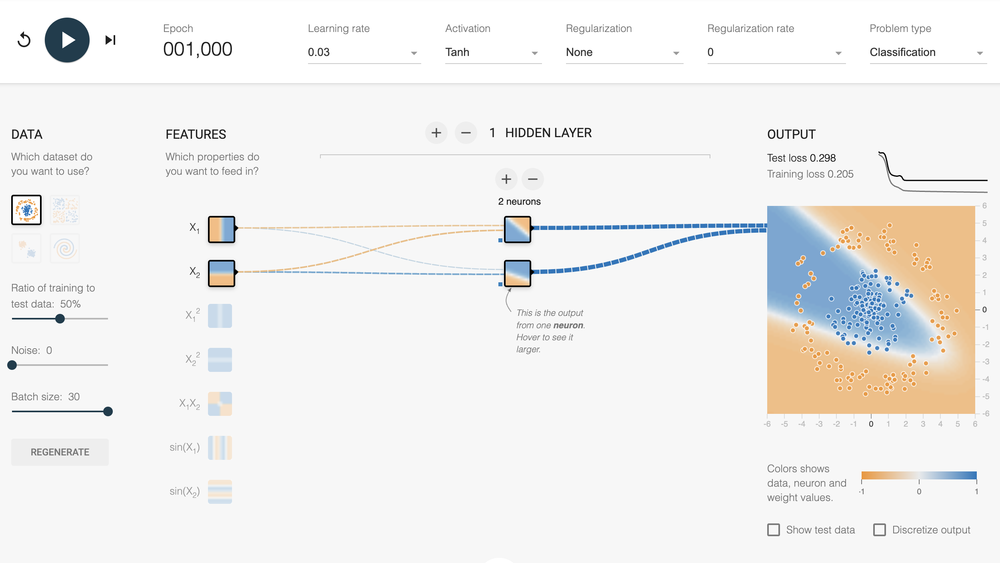
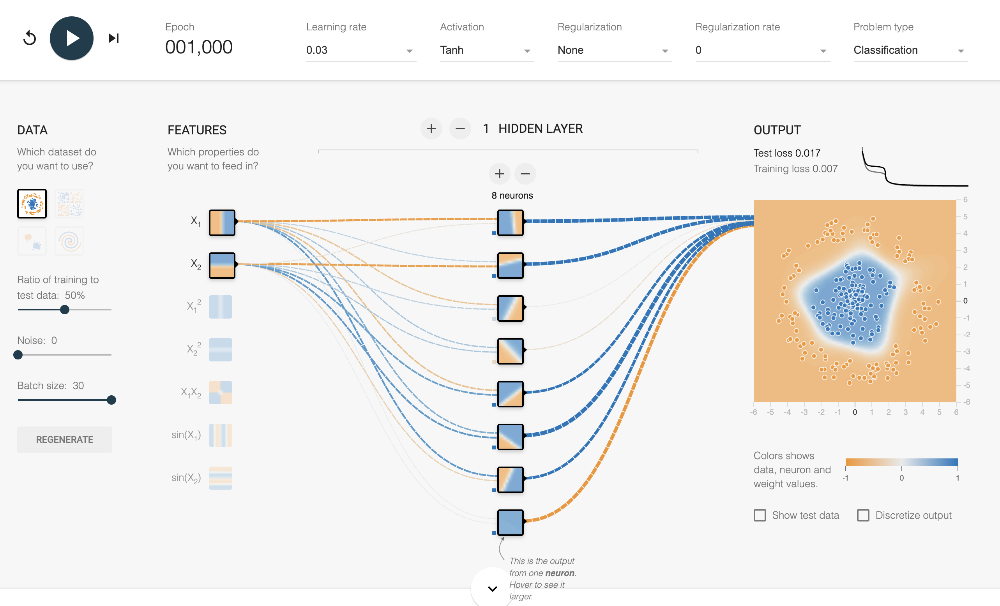

Learning rate vs Losses (Training & Test) after specific epochs:

Learning Rate: 10

After 100 epochs: Training Loss: 0.704, Test Loss: 0.696
After 500 epochs: Training Loss: 0.608, Test Loss: 0.776
After 1000 epochs: Training Loss: 0.656, Test Loss: 0.800

Learning Rate: 1

After 100 epochs: Training Loss: 0.003, Test Loss: 0.036
After 500 epochs: Training Loss: 0.001, Test Loss: 0.034
After 1000 epochs: Training Loss: 0.000, Test Loss: 0.032

Learning Rate: 0.1

After 100 epochs: Training Loss: 0.033, Test Loss: 0.034
After 500 epochs: Training Loss: 0.008, Test Loss: 0.011
After 1000 epochs: Training Loss: 0.004, Test Loss: 0.009

Learning Rate: 0.01

After 100 epochs: Training Loss: 0.402, Test Loss: 0.414
After 500 epochs: Training Loss: 0.212, Test Loss: 0.304
After 1000 epochs: Training Loss: 0.179, Test Loss: 0.286

Learning Rate: 0.0001

After 100 epochs: Training Loss: 0.536, Test Loss: 0.522
After 500 epochs: Training Loss: 0.524, Test Loss: 0.517
After 1000 epochs: Training Loss: 0.514, Test Loss: 0.513

Observations: (note: these numbers change based on each different run)

Loss vs Learning Rate:

For a very high learning rate (10), the training and test losses are fluctuating, indicating that the model might be overshooting the global minimum.
For a learning rate of 1, the model converges rapidly to a very small training loss, but the test loss is relatively higher, indicating potential overfitting.
As the learning rate decreases (0.1, 0.01), the model tends to generalize better with a balance between training and test losses.
For the smallest learning rate (0.0001), the losses decrease very slowly, showing signs of slow convergence.

Loss vs Epoch numbers:

For higher learning rates (10 and 1), the number of epochs doesn't lead to consistent improvement, especially for the test dataset. This suggests that the model might be bouncing around the optimum due to large learning rate steps.
For smaller learning rates (0.1 and 0.01), the loss tends to decrease as epochs increase, showing better and smoother convergence.
For the smallest learning rate (0.0001), the rate of decrease in loss across epochs is slowest, making it less efficient for quick convergence.

Training and Test Loss Curve:

High learning rates lead to noisy loss curves, causing oscillations.
Lower learning rates result in smoother curves, but too low rates (like 0.0001) show slow convergence.


In summary, selecting an appropriate learning rate is crucial for model training. Too high can cause overshooting, while too low can lead to slow convergence. The best learning rate often lies in between and requires experimentation based on the specific problem and dataset.

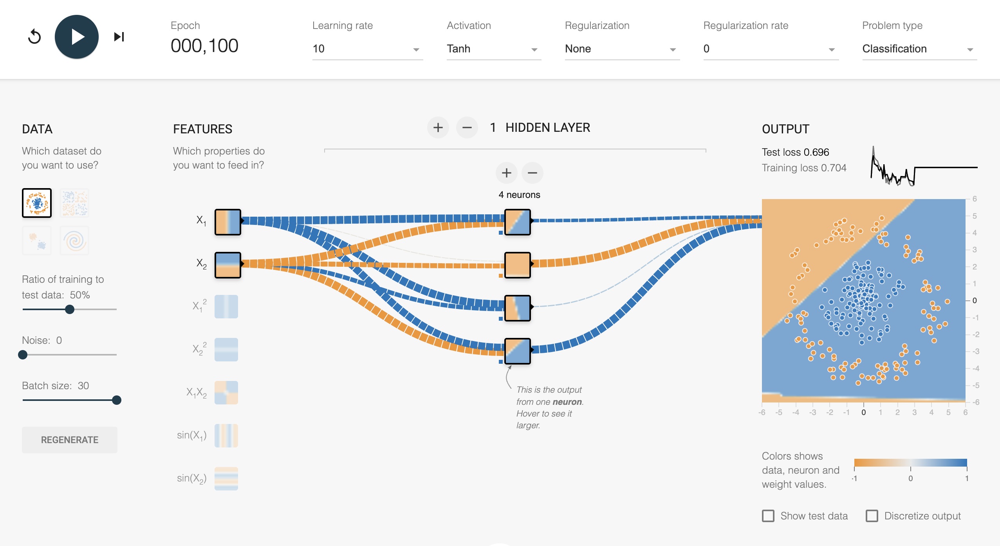
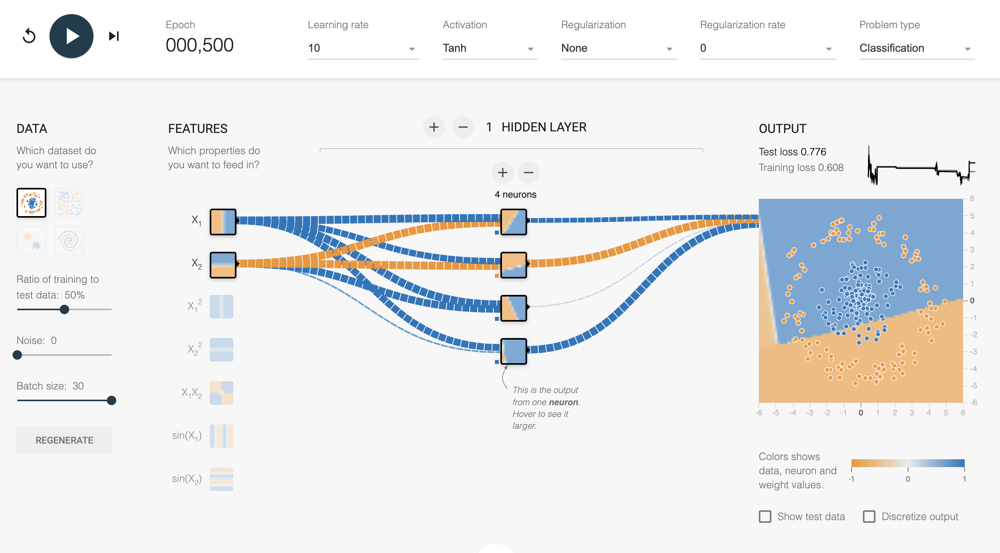
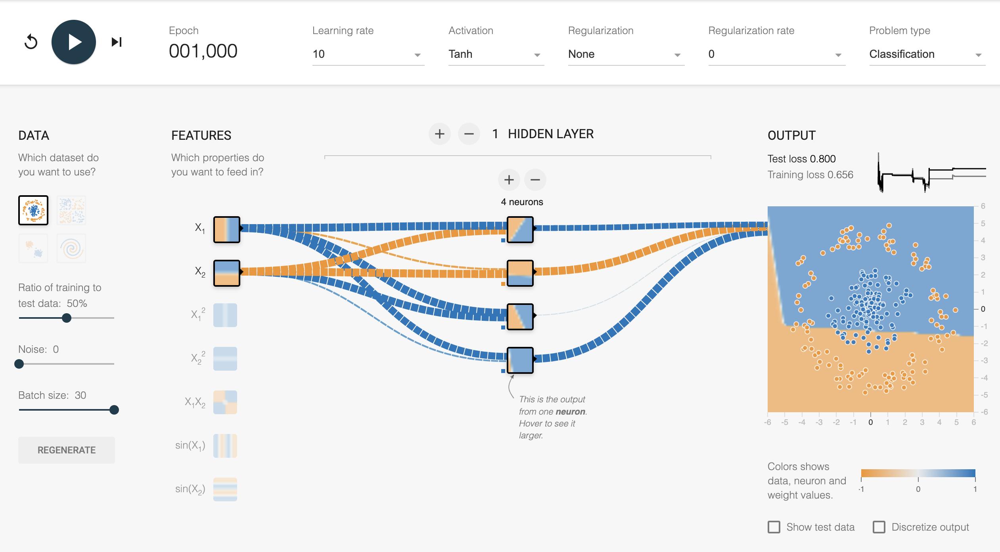
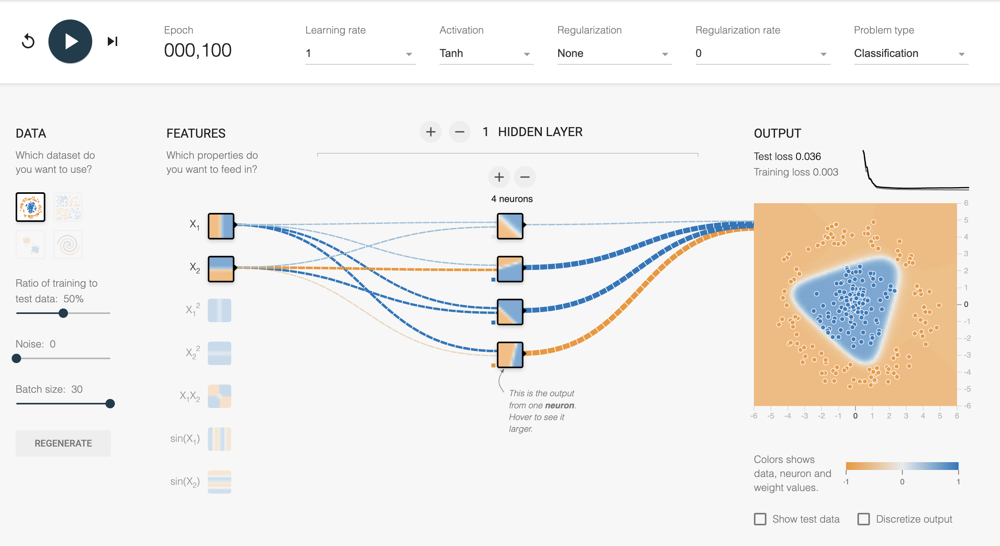
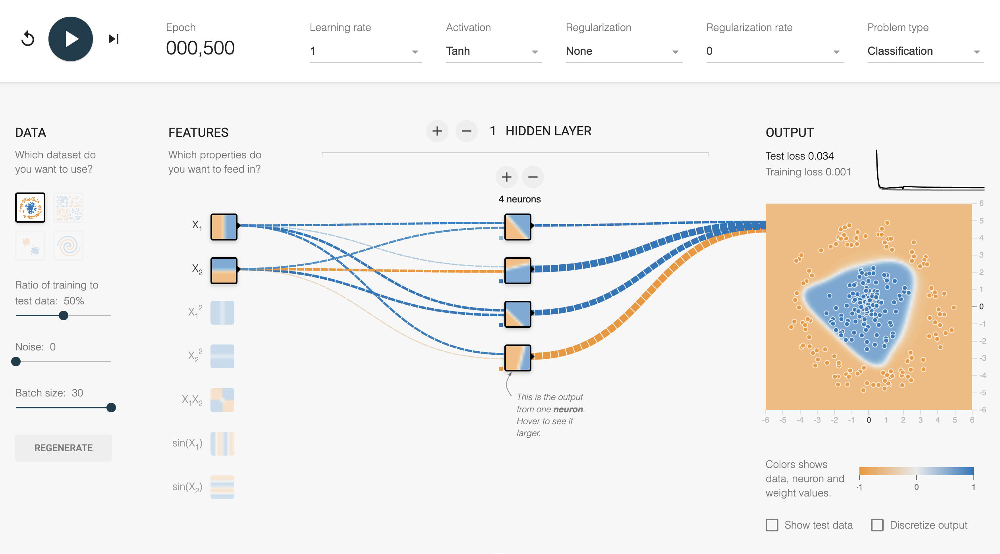
...
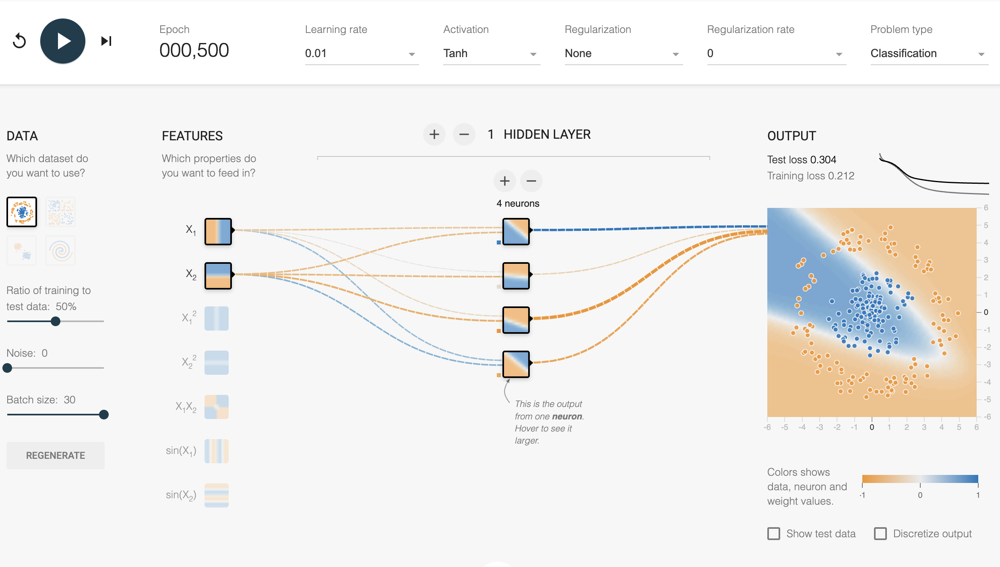
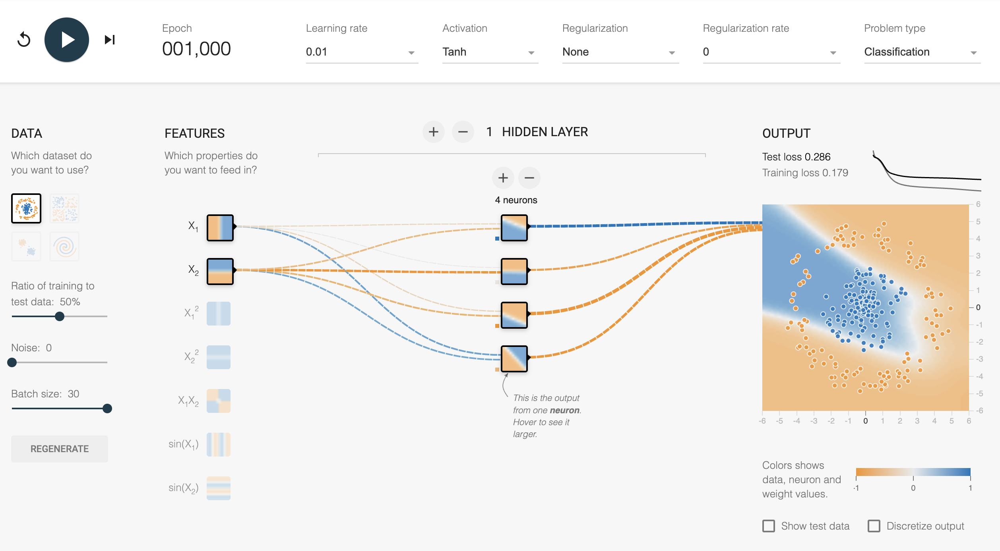
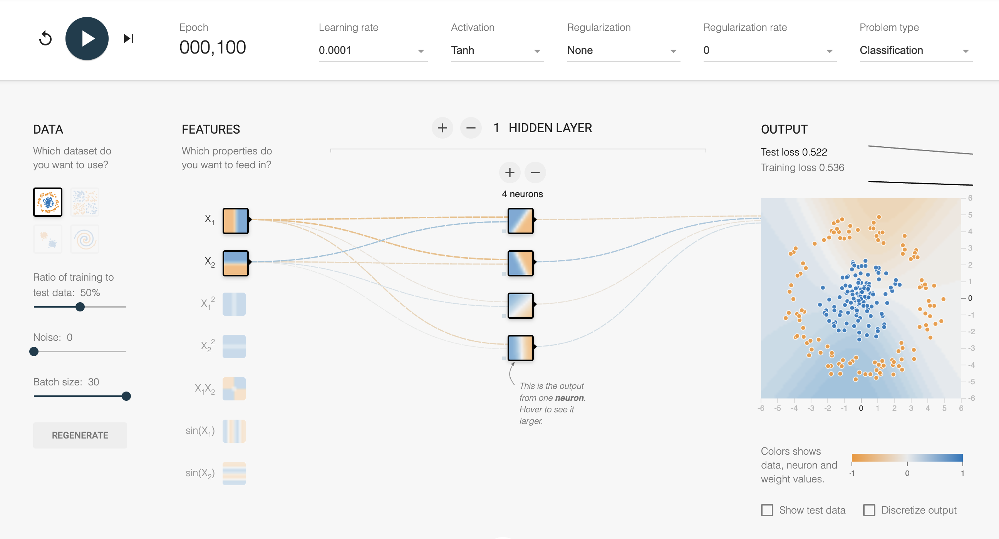
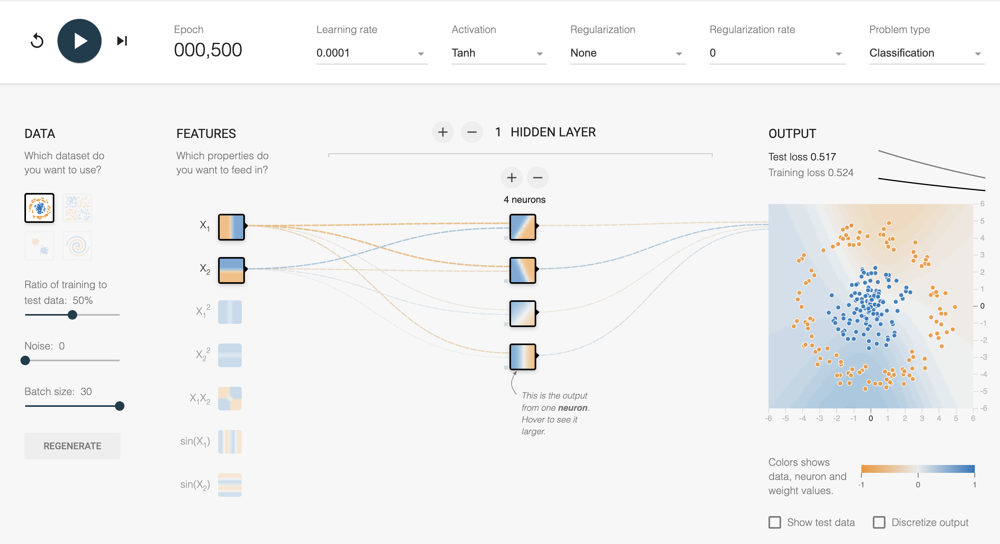
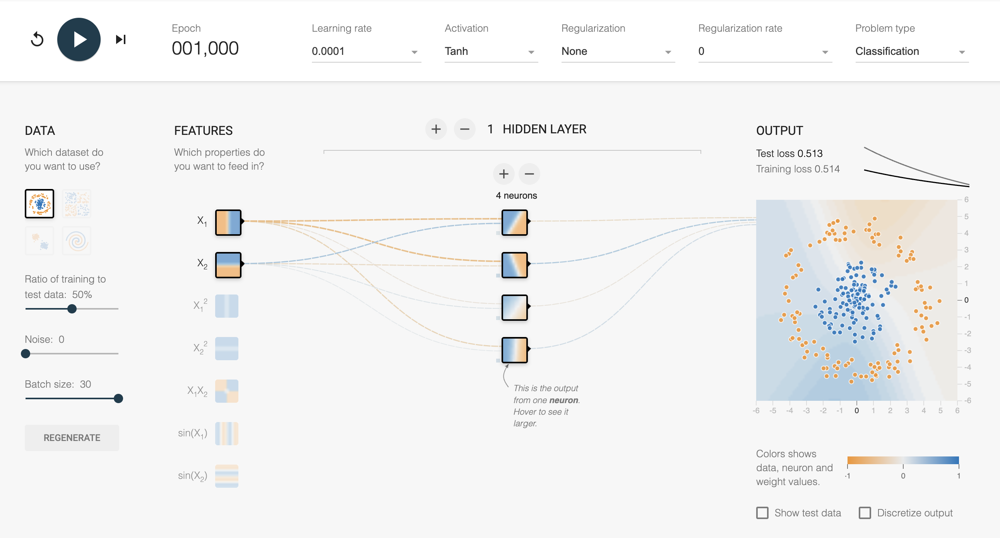


One hidden layer, 4 neurons: Test Loss: 0.015, Training Loss: 0.008

Two Hidden Layers (1st layer with 4 neurons & 2nd layer with 3 neurons): Test Loss: 0.002, Training Loss: 0.001

The model with two hidden layers performs better, having a lower training and test loss compared to the single layer model. This suggests that adding complexity (more layers) has helped the model fit better to the data.

The decision boundary for both models is intricate, capturing the underlying patterns in the data. The two-layer model appears to have a more refined decision boundary, which might be due to the added complexity allowing for capturing more nuanced patterns in the data.

Both models converge well. However, the two-layer model has achieved a significantly faster and lower loss, indicating a better fit.

The addition of an extra hidden layer with the ReLU activation function has allowed the neural network to better capture the intricacies of the data, resulting in a more accurate model. 


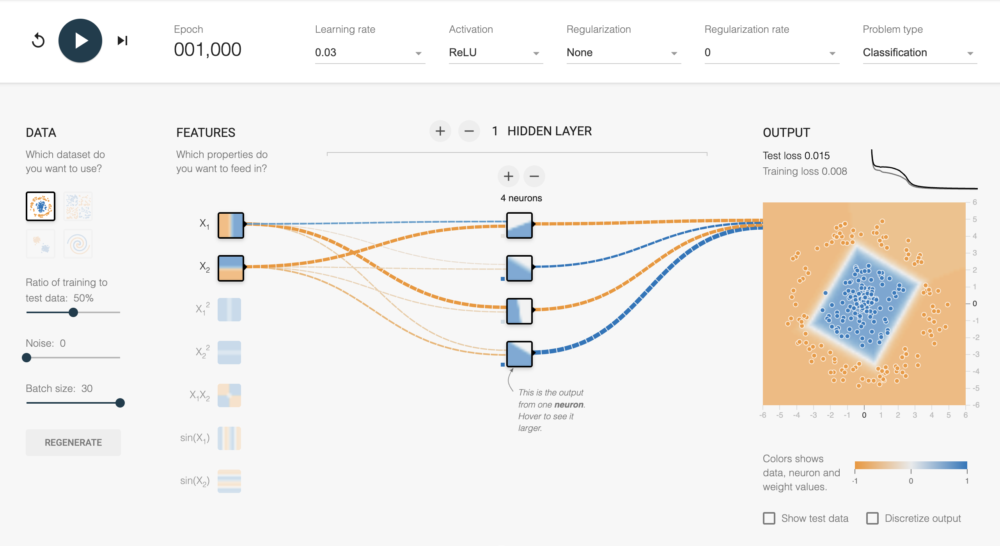
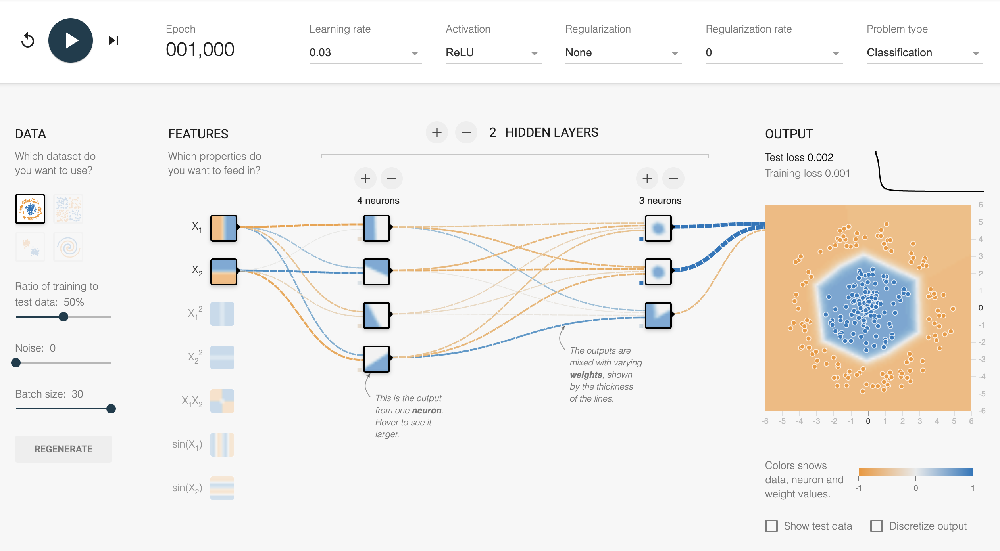


Since it already falls below 0.06 after 200 epochs under DEFAULT setting, I chose to run 200 epochs to get higher test loss and work from there:

DEFAULT, under 200 epochs:
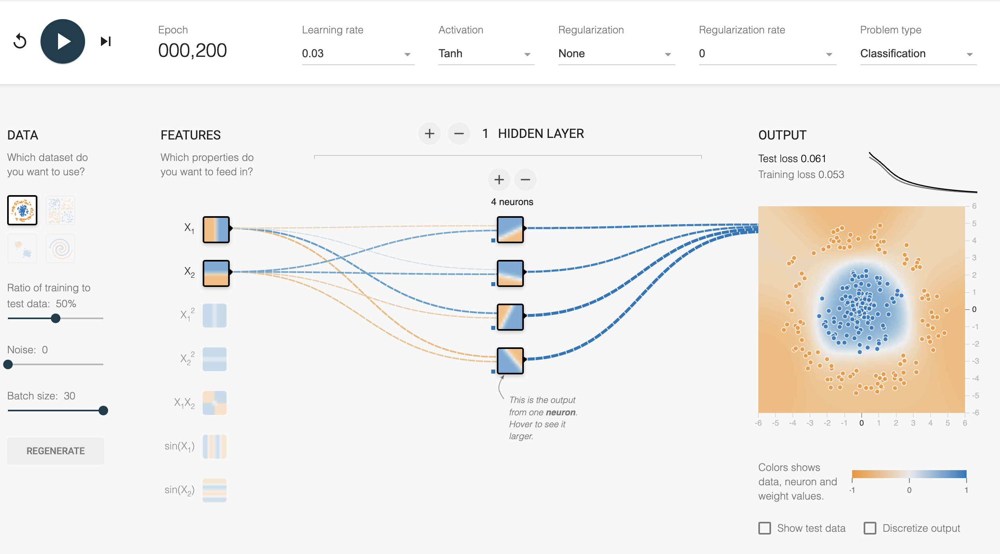


Then, adding regularization:
It doesn't work because regularization is used mainly to prevent overfitting. And we can see it increased the errors:

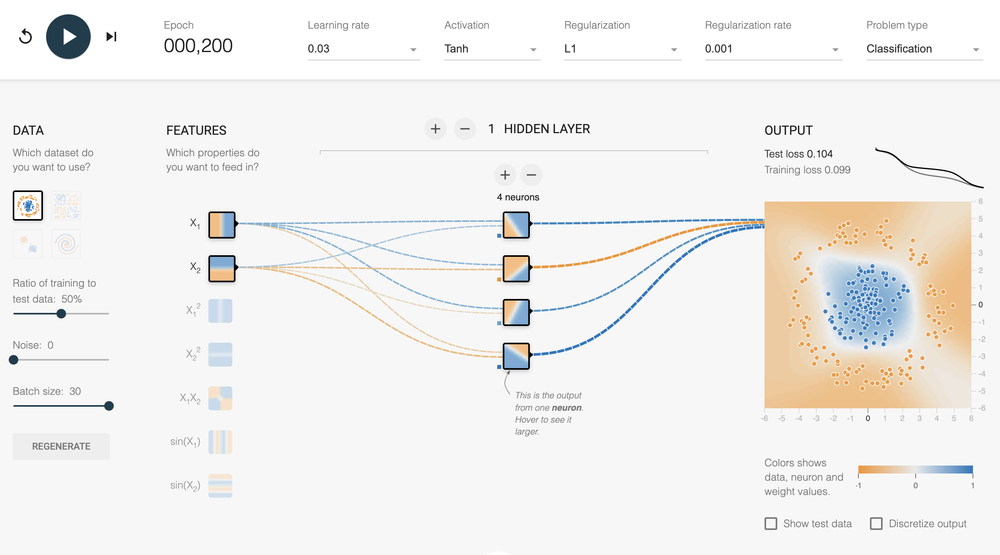


Then, adding another feature sin(X1): not much improvement
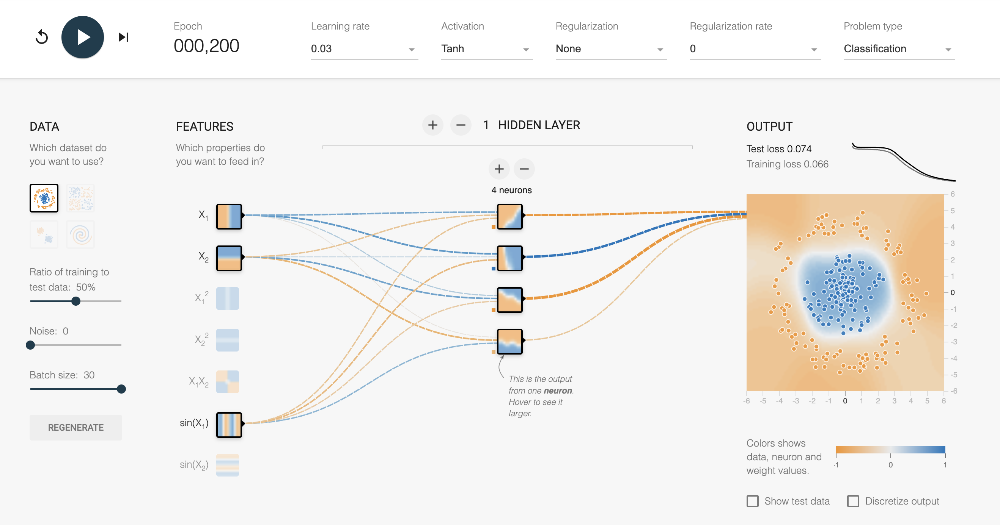

Then, adding more neurons: it improves as you add more layers

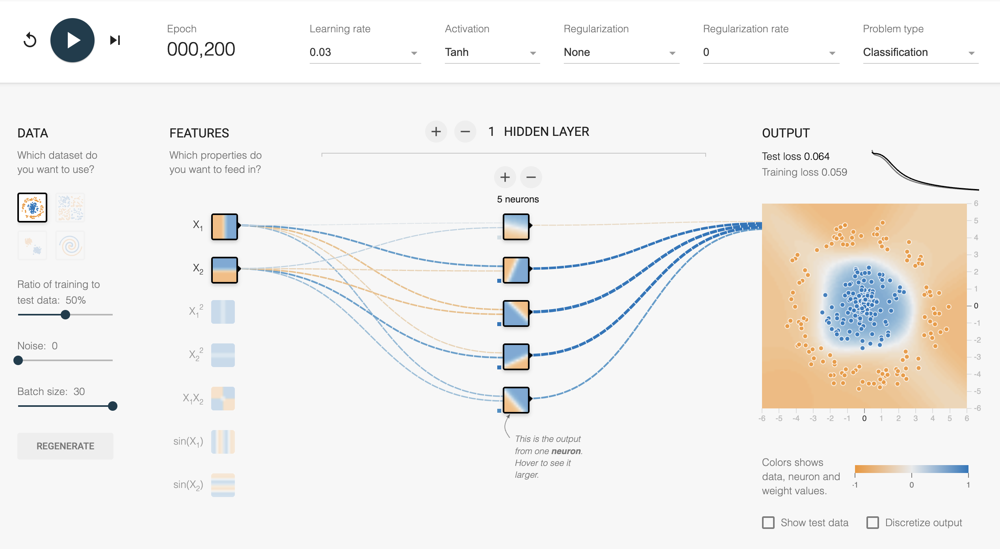
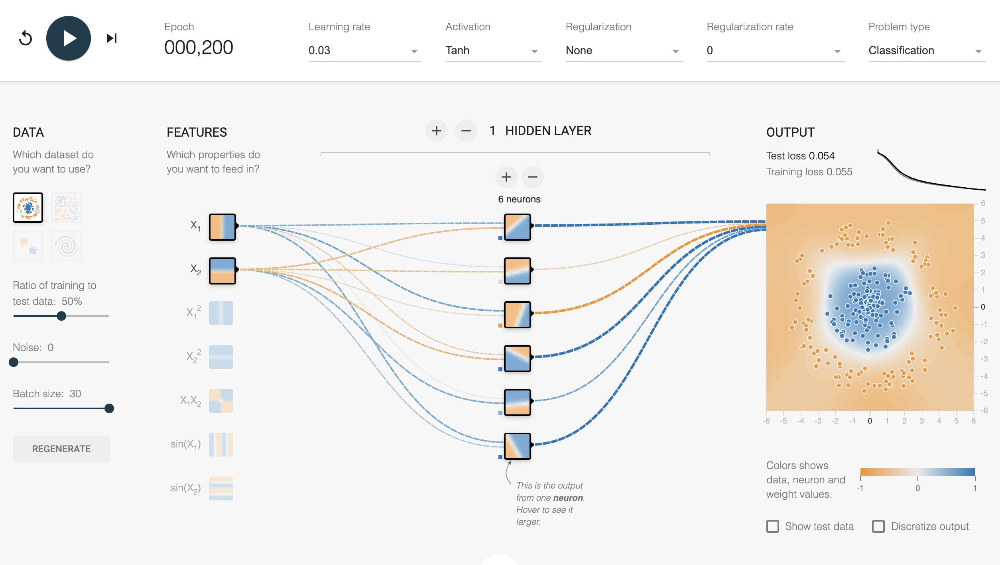

And adding more features further improves the model:

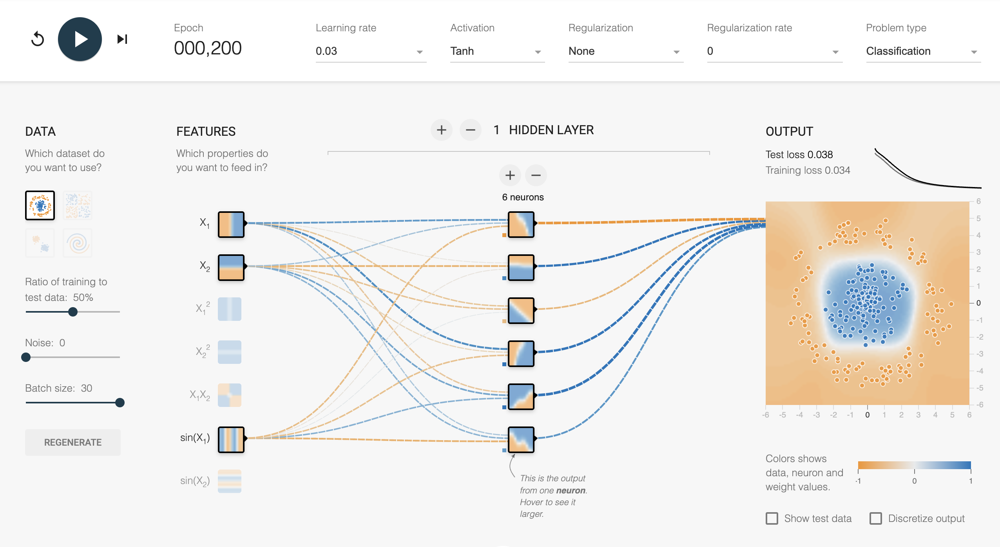

Adding more hidden layers (2 and more hidden layers):

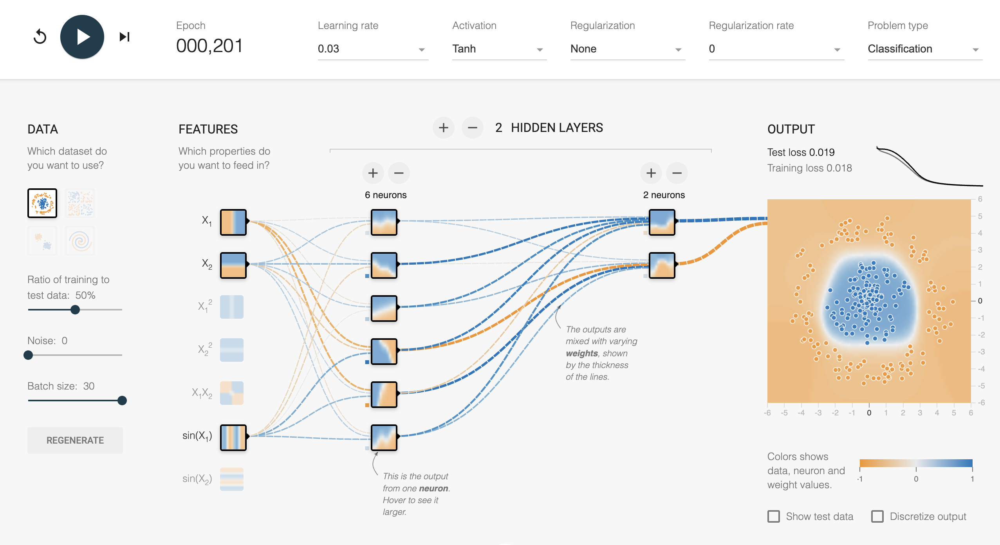
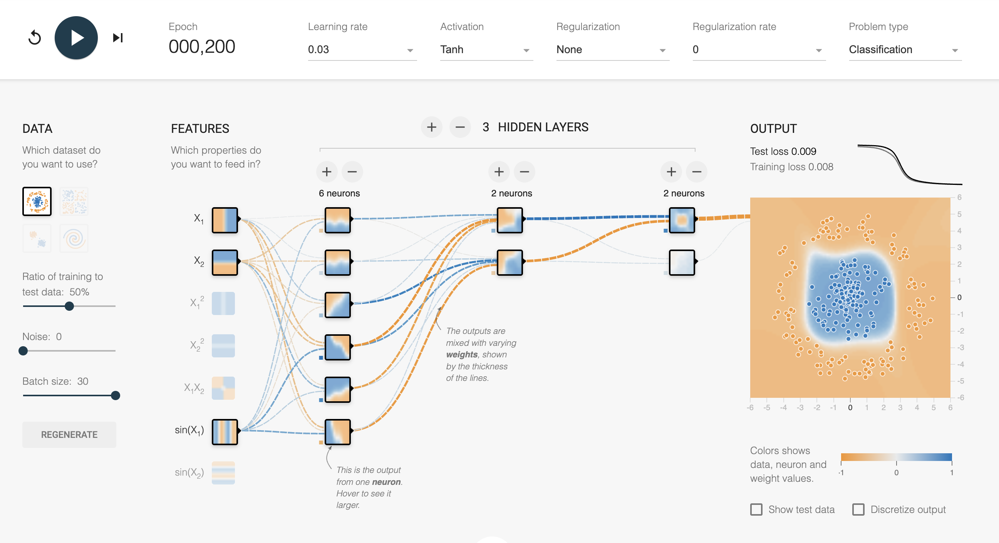

Interestingly at 2 hideen layers it started to perform worse:
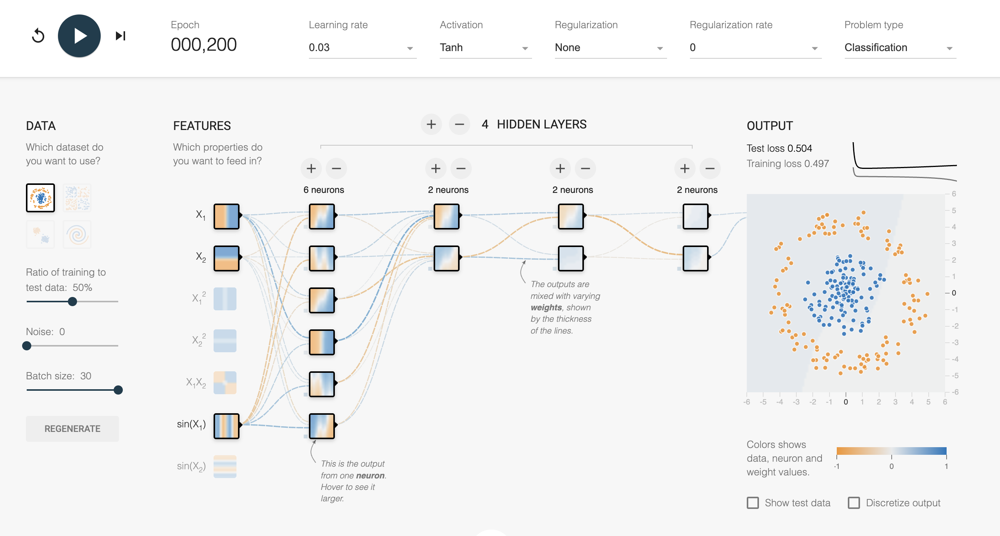

So, the best:

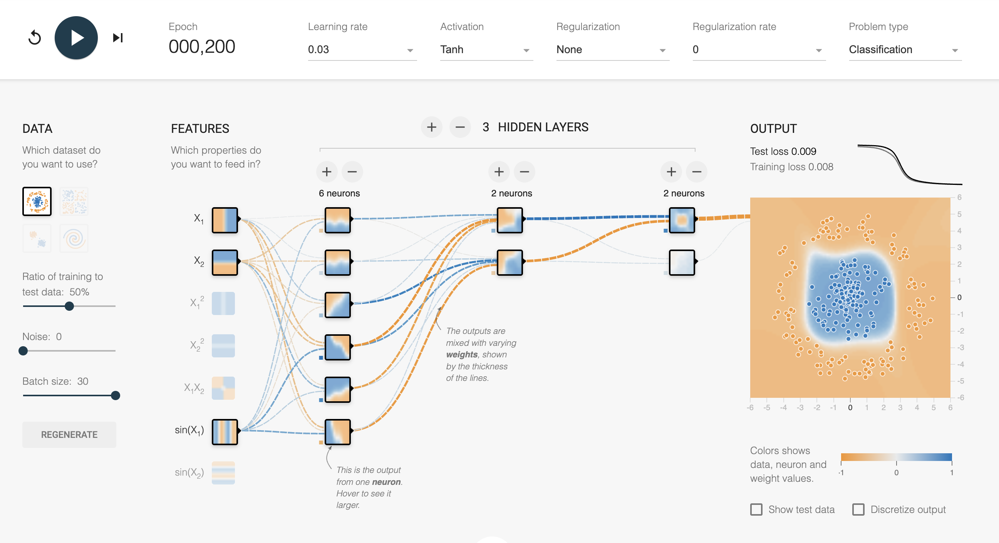


A set of data points $\{x_1, x_2, ... x_N\}$ where each $x_i \in \mathbb{R}^d$, given to you after centering, i.e., $\frac{1}{N}\sum_{i=1}^{N}x_i = 0$.

Project this data on a single unit vector given by $u$ by learning an appropriate $u$. Showing that, for learning $u$, minimizing the residual of the projections computed by the squared error between the projected data and the original data is equivalent to maximizing the variance of the projections.


The projection of $x_i$ onto the unit vector $u$ is given by: 

$y_i = (x_i^T u)u$  

The squared error between the original data and projected data is:

$E = \sum_{i=1}^N \|x_i - y_i\|^2$

Substituting the projection formula:

$E = \sum_{i=1}^N \|x_i - (x_i^T u)u\|^2$

Expanding:

$E = \sum_{i=1}^N (x_i^T x_i - 2(x_i^T u)^2 + (x_i^T u)^2)$

$= \sum_{i=1}^N x_i^T x_i - \sum_{i=1}^N (x_i^T u)^2$

Since $\sum_{i=1}^N x_i^T x_i$ is constant, minimizing $E$ is equivalent to maximizing $\sum_{i=1}^N (x_i^T u)^2$, which is the variance of the projections.


# Principal Component Analysis

Applying PCA and T-SNE on the Superconductivity Dataset. More details on the dataset is present [here](https://archive.ics.uci.edu/ml/datasets/Superconductivty+Data#). The goal here is to predict the critical temperature of a superconductor based on the features extracted.

First use Principal Component Analysis (PCA) to solve this problem.  

Following steps to prepare the dataset:

    * Load the dataset from the "Q4data.csv" file provided as a dataframe df.

    * Select the **'critical_temp'** column as the target column and the rest of the columns from the dataframe df as X.

    * Split the dataset into train and test set with 35% data in test set and random_state = 42

    * Perform [Standard Scaling](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html#sklearn.preprocessing.StandardScaler) on the dataset. Remember that when we have training and testing data, we fit preprocessing parameters on training data and apply them to all testing data. You should scale only the features (independent variables), not the target variable y.

In [13]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SequentialFeatureSelector
import os, sys, re
import time
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import matplotlib.pyplot as plt
df = pd.read_csv("Q4data.csv")

In [14]:
y = df["critical_temp"]
X = df.drop(columns=["critical_temp"])

X_train, X_test, Y_train, Y_test = train_test_split(X, y, test_size=0.30, random_state=42)

scaler = StandardScaler()

### START CODE ###
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
### END CODE ###

[PCA](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) and reducing the dimension of X_train to the following number of components: `[3,20,40,60,81]`. For each of the five datasets, printing the cumulative variance explained by the principal components`N = [3,20,40,60,81]`.(i.e. what percentage of variance in the original dataset is explained if we transform the dataset to have 3,20,40,60 and 81 principal components respectively).

In [15]:
from sklearn.decomposition import PCA
nums = [3,20,40,60,81]
res = []
for num in nums:
    ### START CODE ###
    pca = PCA(n_components=num)
    pca.fit(X_train_scaled)
    ### END CODE ###

    ### START CODE ###
    X_train_pca = pca.transform(X_train_scaled)
    ### END CODE ###

    ### START CODE ###
    var = np.sum(pca.explained_variance_ratio_) * 100  # Multiply by 100 to get percentage
    ### END CODE ###
    
    print(f"Cumulative variance explained by {num} components is {var:.1f}")

Cumulative variance explained by 3 components is 58.9
Cumulative variance explained by 20 components is 96.9
Cumulative variance explained by 40 components is 99.6
Cumulative variance explained by 60 components is 100.0
Cumulative variance explained by 81 components is 100.0


Plotting the cumulative variance explained by the principal components using the training data. The plot should display the number of components on X-axis and the cumulative explained variance on the y-axis.

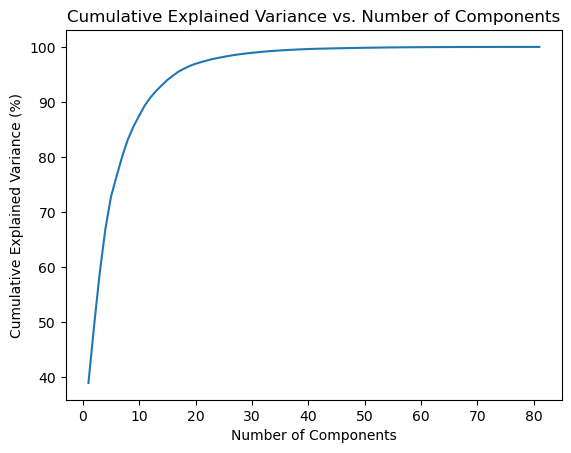

In [16]:
### START CODE ###
pca = PCA()
pca.fit(X_train_scaled)

# Get the explained variance ratio and calculate the cumulative sum
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Plotting
plt.plot(range(1, 82), cumulative_variance * 100)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance (%)')
plt.title('Cumulative Explained Variance vs. Number of Components')
### END CODE ###

plt.show()

For each of the reduced dataset, obtained in part 2.2, fit a linear regression model on the train data and show how adjusted $R^2$ varies as a function of # of components.(There will be a total of 5 ${R^2}$ score).


In [17]:
from sklearn.decomposition import PCA
nums = [3,20,40,60,81]
res = []
for num in nums:

    ### START CODE ###
    pca = PCA(n_components=num)
    pca.fit(X_train_scaled)
    ### END CODE ###

    ### START CODE ###
    X_train_pca = pca.transform(X_train_scaled)
    X_test_pca = pca.transform(X_test_scaled)
    ### END CODE ###

    ### START CODE ###
    explained_variance = np.sum(pca.explained_variance_ratio_)
    ### END CODE ###

    ### START CODE ###
    lr = LinearRegression()
    lr.fit(X_train_pca, Y_train)
    r_squared = lr.score(X_test_pca, Y_test)
    ### END CODE ###
    
    print(f"R^2 score {r_squared:.4f} with num_components {num}")

    adjusted_r_squared = 1 - (1 - r_squared) * (len(Y_test) - 1) / (len(Y_test) - X_test_pca.shape[1] - 1)
    print(f"Adjusted R^2 {adjusted_r_squared:.4f}")

R^2 score 0.4892 with num_components 3
Adjusted R^2 0.4890
R^2 score 0.6215 with num_components 20
Adjusted R^2 0.6203
R^2 score 0.6865 with num_components 40
Adjusted R^2 0.6846
R^2 score 0.7145 with num_components 60
Adjusted R^2 0.7118
R^2 score 0.7281 with num_components 81
Adjusted R^2 0.7246


#  PCA vs T-SNE

In [2]:
from sklearn.manifold import TSNE

tsne_model = TSNE(n_components=3, perplexity=300, n_iter=300, random_state=42)

X_train_tsne = tsne_model.fit_transform(X_train_scaled)

* Using a small subset of 500 samples of the training dataset and plot the first three t-SNE components

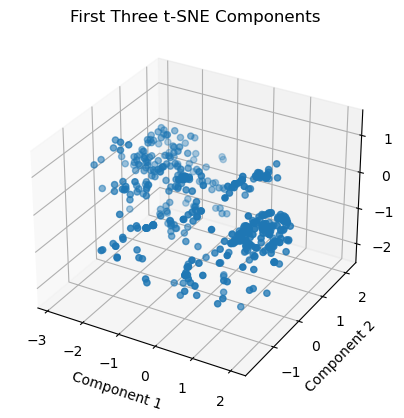

In [19]:
# Apply t-SNE on the subset of the training dataset
X_train_subset = X_train_scaled[:500]
X_train_tsne_500 = tsne_model.fit_transform(X_train_subset)

# Importing matplotlib for plotting
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D scatter plot for the t-SNE components
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(X_train_tsne_500[:, 0], X_train_tsne_500[:, 1], X_train_tsne_500[:, 2])
ax.set_xlabel('Component 1')
ax.set_ylabel('Component 2')
ax.set_zlabel('Component 3')
plt.title('First Three t-SNE Components')
plt.show()

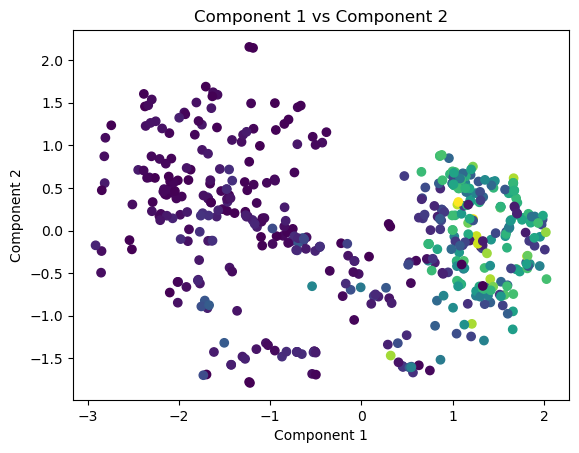

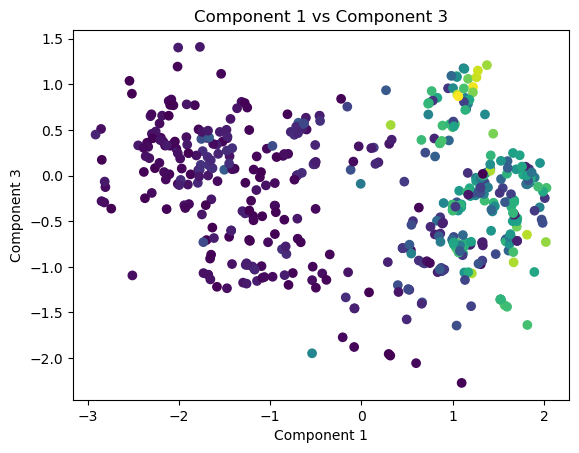

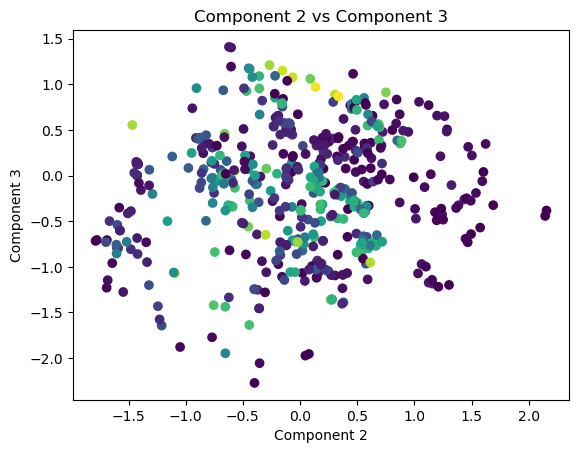

In [20]:
# Plot Component 1 vs Component 2
plt.figure()
plt.scatter(X_train_tsne_500[:, 0], X_train_tsne_500[:, 1], c = Y_train.values[:500].astype(int))
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('Component 1 vs Component 2')
plt.show()

# Plot Component 1 vs Component 3
plt.figure()
plt.scatter(X_train_tsne_500[:, 0], X_train_tsne_500[:, 2], c = Y_train.values[:500].astype(int))
plt.xlabel('Component 1')
plt.ylabel('Component 3')
plt.title('Component 1 vs Component 3')
plt.show()

# Plot Component 2 vs Component 3
plt.figure()
plt.scatter(X_train_tsne_500[:, 1], X_train_tsne_500[:, 2], c = Y_train.values[:500].astype(int))
plt.xlabel('Component 2')
plt.ylabel('Component 3')
plt.title('Component 2 vs Component 3')
plt.show()

Plotting the PCA and t-SNE projections of the data and compare the plots side-by-side to see the difference in scatters created by the two methods.

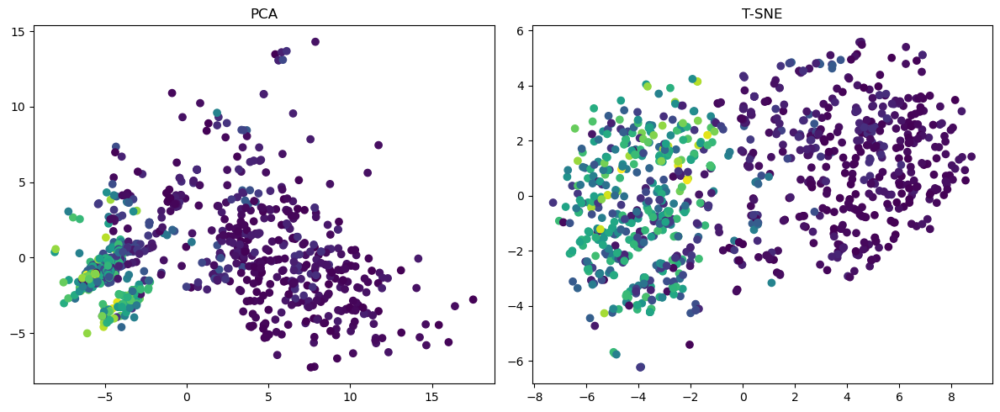

In [21]:
plt.figure(figsize=(12, 5))  # Adjust the figure size as needed

# First subplot (left)
plt.subplot(1, 2, 1)

y_train_1000 = Y_train[:1000]

pca = PCA(n_components=3)
X_train_pca_1000 = pca.fit_transform(X_train_scaled[:1000])
plt.scatter(X_train_pca_1000[:, 0], X_train_pca_1000[:, 1], c=y_train_1000)

# plt.subplot(1, 2, 1)  # 1 row, 2 columns, select the first subplot
plt.title('PCA')

# Second subplot (right)
plt.subplot(1, 2, 2)  # 1 row, 2 columns, select the second subplot

tsne_model = TSNE(n_components=3, perplexity=300, n_iter=300, random_state=42)
X_train_tsne_1000 = tsne_model.fit_transform(X_train_scaled[:1000])
plt.scatter(X_train_tsne_1000[:, 0], X_train_tsne_1000[:, 1], c=y_train_1000)

plt.title('T-SNE')

# Adjust spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()